<img src="seminarlogo.png" class="center" style="width:100%;"> </img>

# <span style="color:navy"> **Seminar Project:** </span> <span style="color:green"> **Video Coding**</span>

<div style="background-color:#ebeff7; padding:1.25em; border-radius:1em; border: 1px solid black">

### <span style = "color: navy"> **General Procedure:** </span>
1. Make group of $2$ or $3$ students while coordinating with each other and select one group coordinator.
2. Select one the techniques (MDCT or Lapped Transform)
4. Send us the the selected task (technique) and the list of group members with their <b>a)</b> Matriculation Numbers <b>b)</b> email IDs, and highlighting the group coordinator. Make it in a **table** form.
5. The duration of the seminar project is from **11.06.2024** to **31.07.2024**, with a mid-term meeting with each group from *01.07.2024 to 06.07.2024* (Book an appointment at your convenience)
6. There will be a report at the end of project. The submission date for the report is **31.07.2024**
7. The report and results presentation will held from *01.08.2024 to 15.08.2024* (The specific date for each group will be selected after mutual consensus)


<span style="color:blue"> Note: Further Instructions and procedures may be updated from time to time</span>
    
</div>

## <span style = "color: navy"> **Introduction:** </span>
There are two seminar projects, with the aim to compress the given images (Only use the given image in the base repository). The projects are:
<br>
### **Project-1:** <span style = "color: green"> Image-Compression using MDCT </span>
### **Project-2:** <span style = "color: green"> Image-Compression using Lapped Transform </span>

The projects are team-based work with a group of **2** (minimum) to **3** (maximum) students. You (as a team) are required to select one project and implement the technique (either *MDCT* or *Lapped* Transform). <span style = "color: red">To make a balance in project selection, we can assign either Project-1 or Project-2 to any group.</span>

### <span style = "color: navy"> GET STARTED </span>
The basic building blocks (base algorithm and/or material) of the Projects are provided in the git-repository (https://github.com/Karanraj06/image-compression).
In this repository, the implementation of image compression is done by using simple **DCT** which you can take as your staring point and further develop or modify this base-repository according to the selected project i.e. techniques (*MDCT* or *Lapped* Transform) of selected project.

### <span style = "color: navy"> Project Tasks </span>
1. Take the base repository as base or reference
2. Modify the DCT part with your selected technique (either MDCT or Lapped Transform)
    - For the "MDCT" you need to find out the optimum window, try different windows
    - The "lapped transform" needs to be implemented by Pytorch's Conv2D. For that, the kernel size can be chosen like the MDCT, which is 16x16. In order to get good transform filters, it needs to be trained, and for that you need to use the images in the image coder repository.
5. Compare the results of compression of your modified version with the reference, which is DCT, by using Perceptual Similarity Metric and compression ratio. The repository for Perceptual Similarity Metric measurement is given here (https://github.com/richzhang/PerceptualSimilarity)
6. The expected calculations among others should include the results of "bits per pixel"

### <span style = "color: navy"> Some use full links </span>
1. https://github.com/TUIlmenauAMS/Python-Audio-Coder
2. https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html

##### <span style="color:blue"> Further details will be discussed with the group coordinators and the they are responsible for group coordination</span>

<div style="background-color:#ebeff7; padding:1.25em; border-radius:1em; border: 1px solid black">

### <span style="color:navy; font-size: 1.25em"> **Project:** </span>
#### <span style="color:blue"> Below Enter Matriculation Numbers of each member </span>

</div>

MatriculationNumber = '123456, '

### <span style="color:navy; font-size: 1.25em"> **Description:**</span>
Place to describe the task, procedure, results etc. (delete this line when writting)

In [ ]:
# Place to write your codes etc.
# YOUR CODE HERE

In [1]:
!git clone https://github.com/richzhang/PerceptualSimilarity.git

Cloning into 'PerceptualSimilarity'...


In [2]:
!git clone https://github.com/Karanraj06/image-compression.git

Cloning into 'image-compression'...


In [3]:
!pip install lpips


[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [4]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms

# Define a transform to normalize the data
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

# Load CIFAR-10 dataset
trainset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=128, shuffle=True, num_workers=2)

testset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=128, shuffle=False, num_workers=2)

class LappedTransformCNN(nn.Module):
    def __init__(self):
        super(LappedTransformCNN, self).__init__()
        #in_channels=3, out_channels=64, kernel_size=4, stride=4, padding=0, bias=False
        #12self.conv1 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=8, stride=8, padding=0, bias=False)
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=16, stride=8, padding=0, bias=False)
        self.conv2 = nn.ConvTranspose2d(in_channels=16, out_channels=3, kernel_size=16, stride=8, padding=0, bias=False)

    def forward(self, x):
        x = self.conv1(x)  
        x = self.conv2(x) 
        return x

model = LappedTransformCNN()

criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

num_epochs = 5

for epoch in range(num_epochs):
    running_loss = 0.0
    for i, data in enumerate(trainloader, 0):
        inputs, _ = data 

        optimizer.zero_grad()

        outputs = model(inputs)  
        loss = criterion(outputs, inputs) 
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        if i % 100 == 99:  
            print(f"[{epoch + 1}, {i + 1}] loss: {running_loss / 100:.3f}")
            running_loss = 0.0

print('Finished Training')

# Evaluate the model
model.eval()
total_loss = 0.0
with torch.no_grad():
    for data in testloader:
        inputs, _ = data 
        outputs = model(inputs)
        loss = criterion(outputs, inputs)
        total_loss += loss.item()

print(f'Average test loss: {total_loss / len(testloader):.3f}')

# Save the model
torch.save(model.state_dict(), 'lapped_transform_cnn.pth')


100%|██████████| 170498071/170498071 [00:12<00:00, 14132133.92it/s]


Extracting ./data\cifar-10-python.tar.gz to ./data
Files already downloaded and verified
[1, 100] loss: 0.106
[1, 200] loss: 0.045
[1, 300] loss: 0.031
[2, 100] loss: 0.021
[2, 200] loss: 0.018
[2, 300] loss: 0.017
[3, 100] loss: 0.015
[3, 200] loss: 0.015
[3, 300] loss: 0.015
[4, 100] loss: 0.015
[4, 200] loss: 0.015
[4, 300] loss: 0.015
[5, 100] loss: 0.014
[5, 200] loss: 0.014
[5, 300] loss: 0.014
Finished Training
Average test loss: 0.014


In [5]:
model = LappedTransformCNN()
model.load_state_dict(torch.load('lapped_transform_cnn.pth'))
model.eval()

LappedTransformCNN(
  (conv1): Conv2d(3, 16, kernel_size=(8, 8), stride=(8, 8), bias=False)
  (conv2): ConvTranspose2d(16, 3, kernel_size=(8, 8), stride=(8, 8), bias=False)
)

In [8]:
import os
import torch
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import lpips

image_paths = []
images = []
byte_streams = []
quantized_images = []
scales = []
min_vals = []


for filename in os.listdir('image-compression/images/colored'):
    if filename.endswith('.png'):
        image_paths.append(os.path.join('image-compression/images/colored', filename))

for path in image_paths:
    image = Image.open(path)
    image = transforms.ToTensor()(image).unsqueeze(0)
    image = (image - 0.5) / 0.5
    images.append(image)

loss_fn = lpips.LPIPS(net='alex').cpu()

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\abuma\anaconda3\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\abuma\anaconda3\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\abuma\anaconda3\Lib\site-packages\lpips\weights\v0.1\alex.pth


Number of original images: 24
Number of reconstructed images: 24
Perceptual similarity (LPIPS): 0.25374680757522583


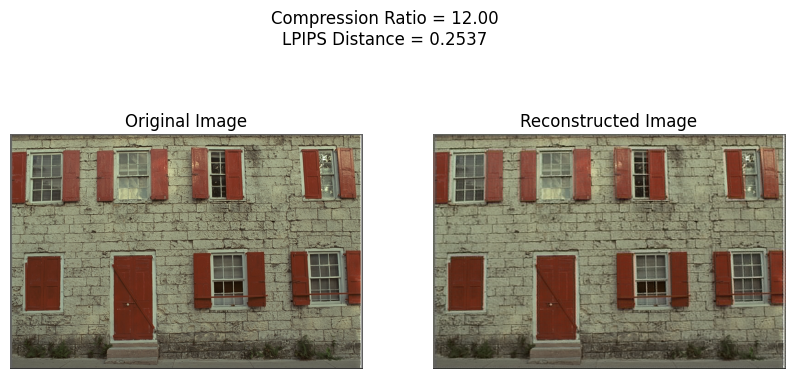

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.16413606703281403


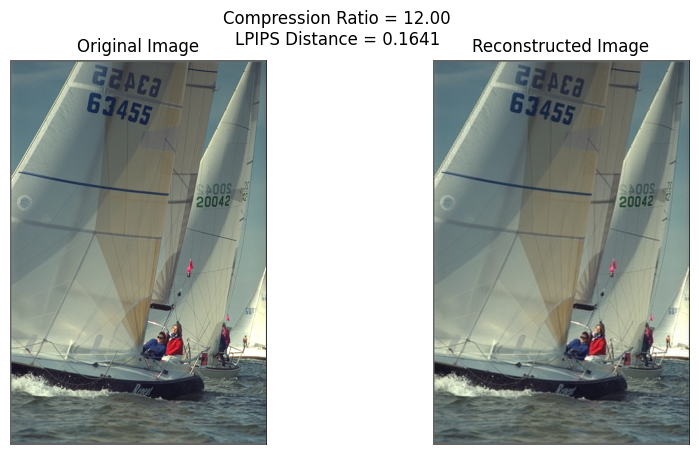

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.21658997237682343


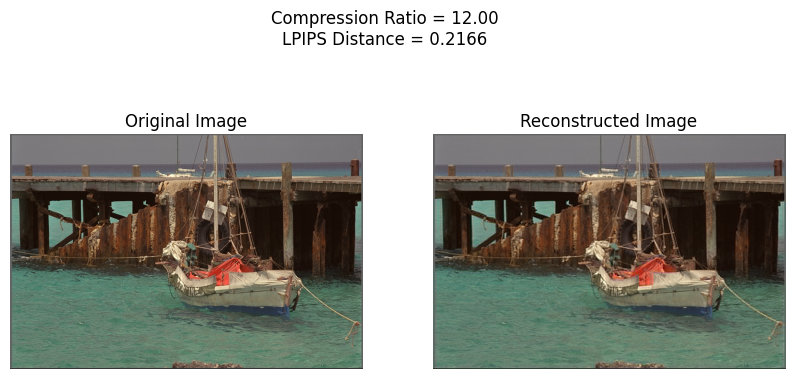

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.16060218214988708


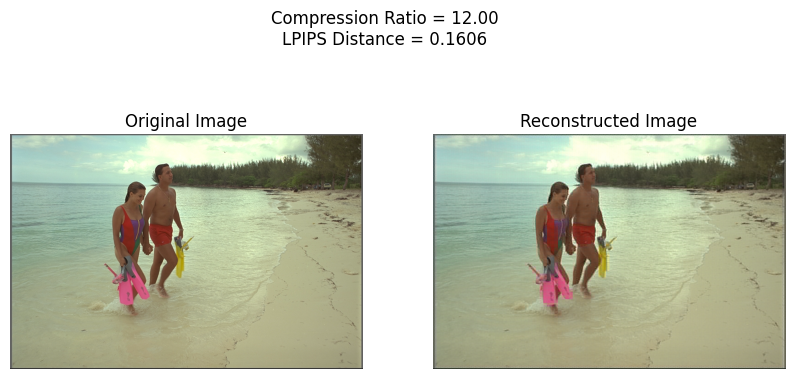

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.35109129548072815


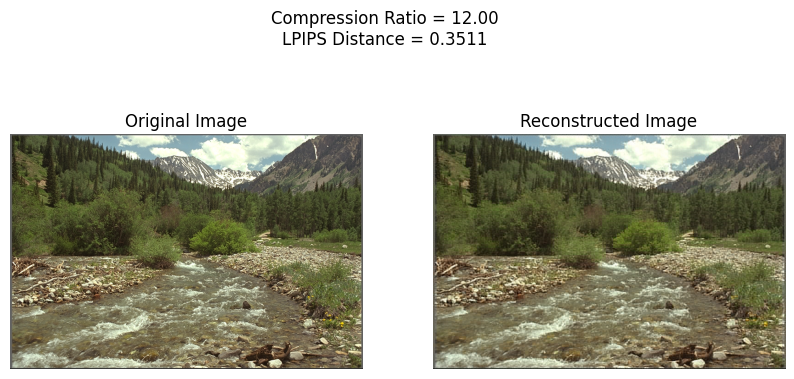

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.23678167164325714


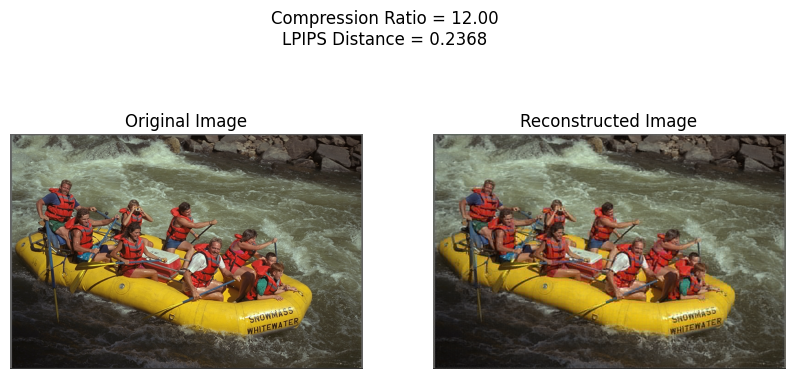

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.17775839567184448


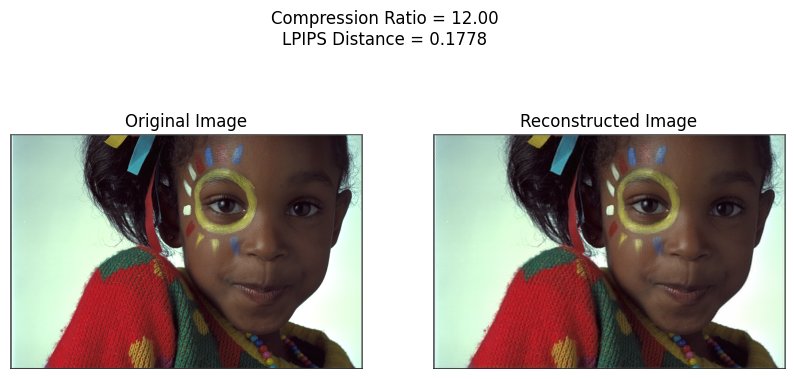

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.17931099236011505


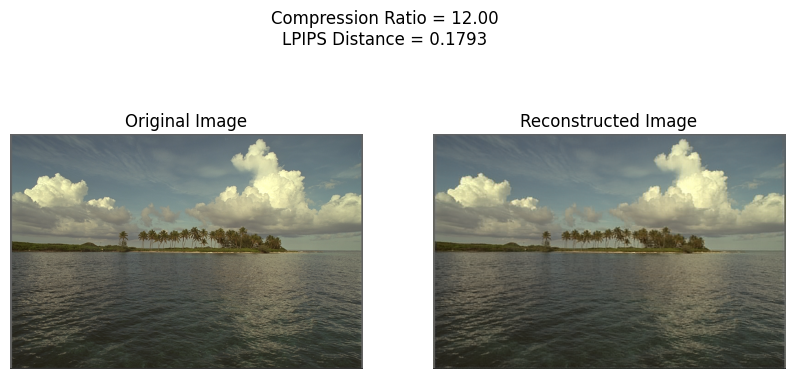

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.14073427021503448


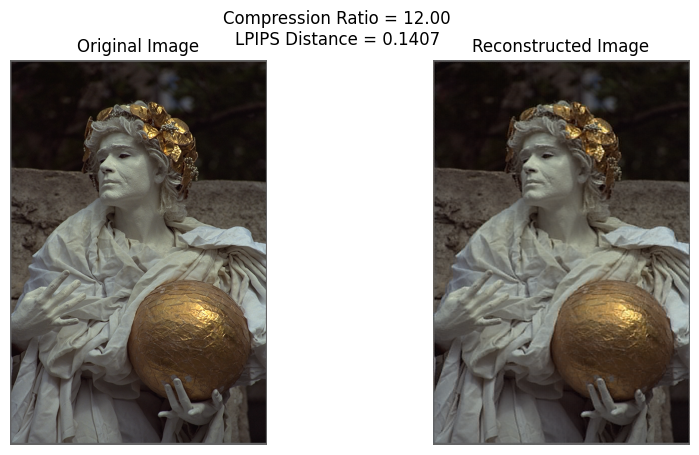

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.22516997158527374


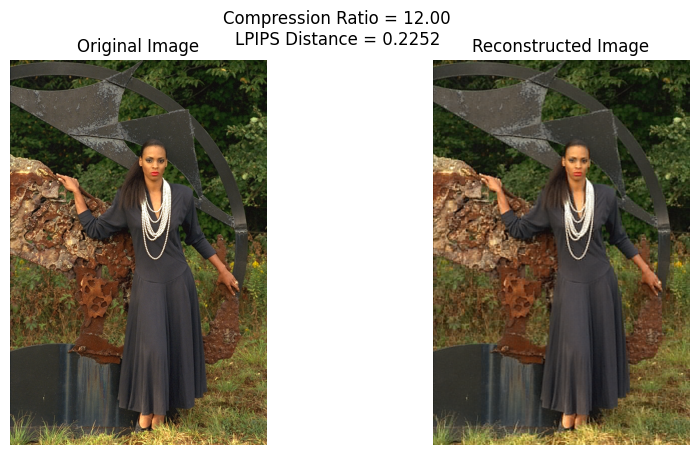

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.22797125577926636


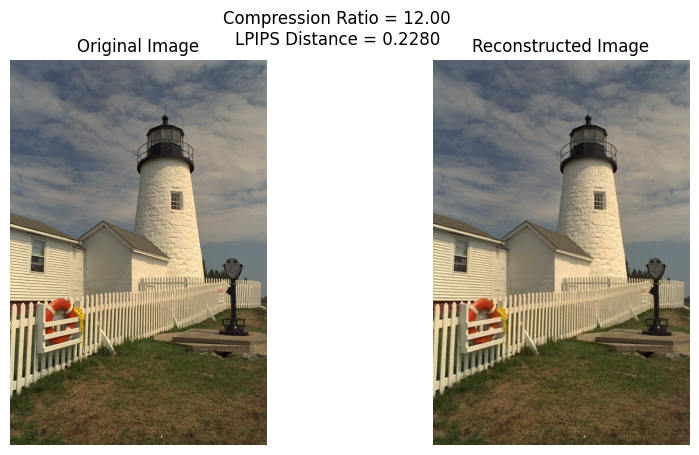

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.22843295335769653


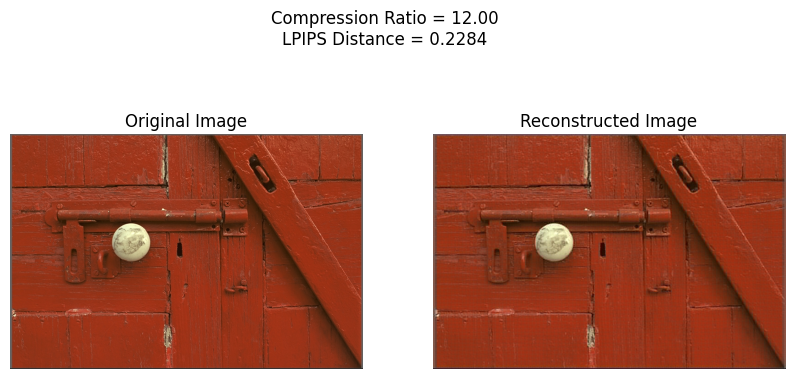

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.1572725623846054


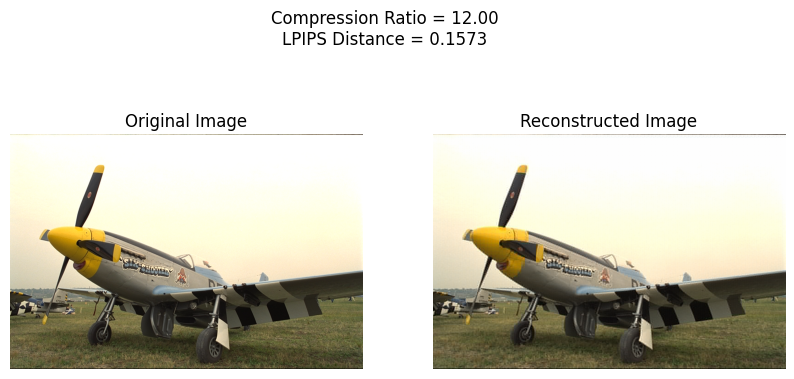

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.2125062346458435


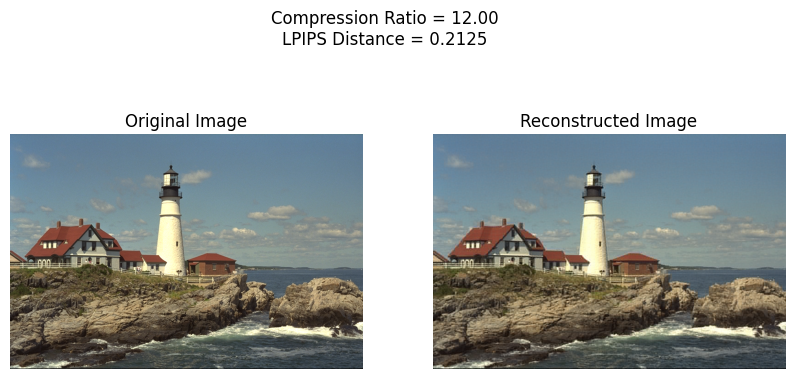

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.2336256504058838


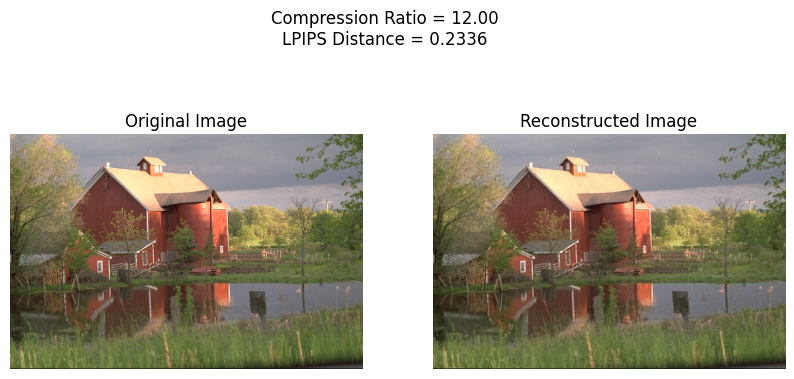

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.09722374379634857


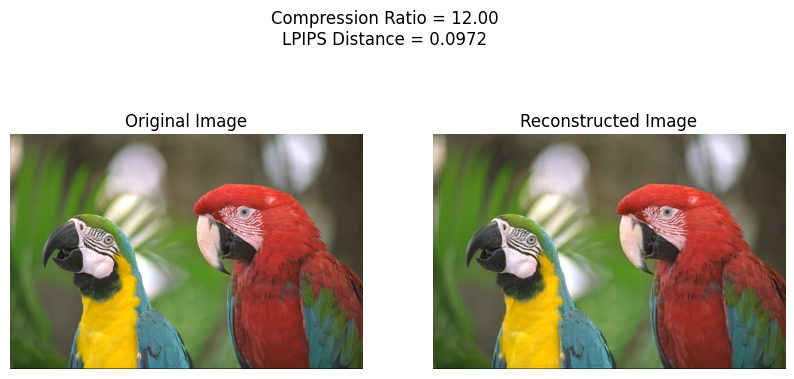

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.21209125220775604


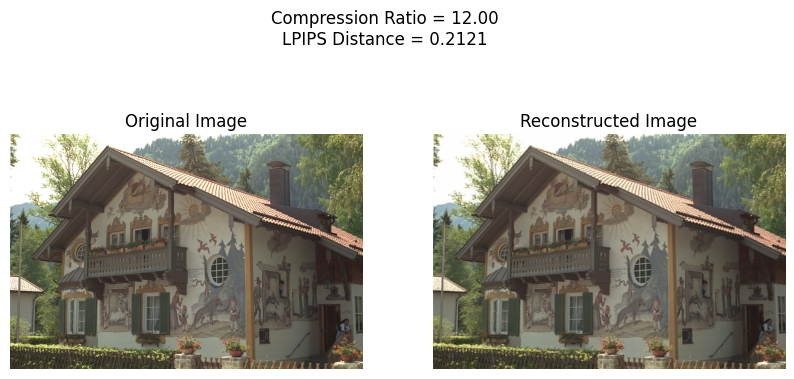

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.10527142137289047


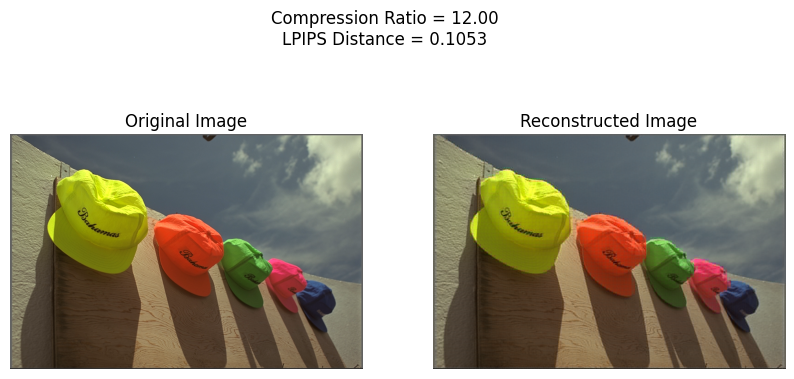

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.1730649769306183


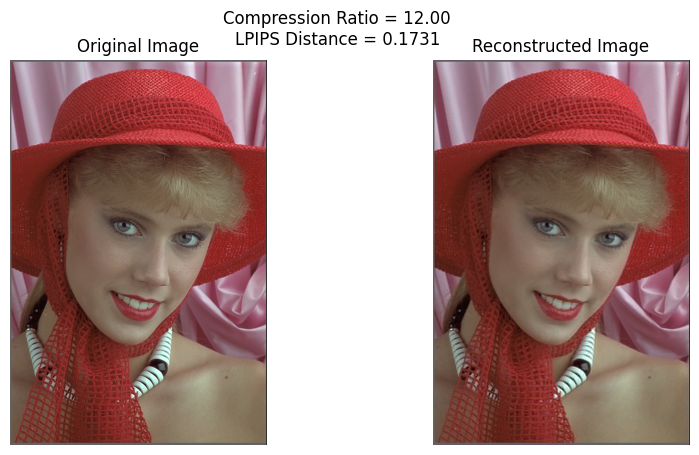

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.1998569369316101


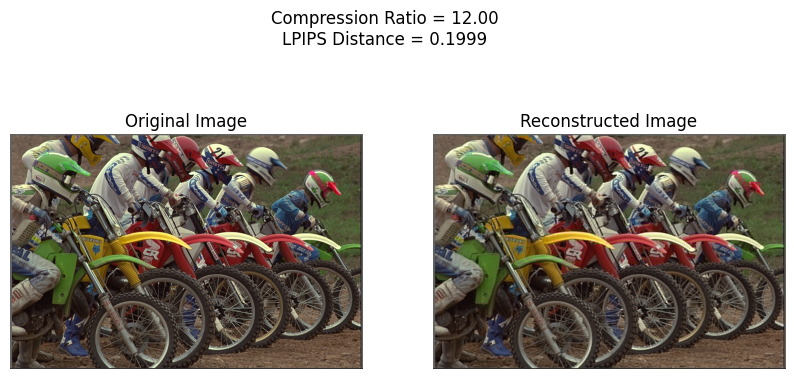

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.22067967057228088


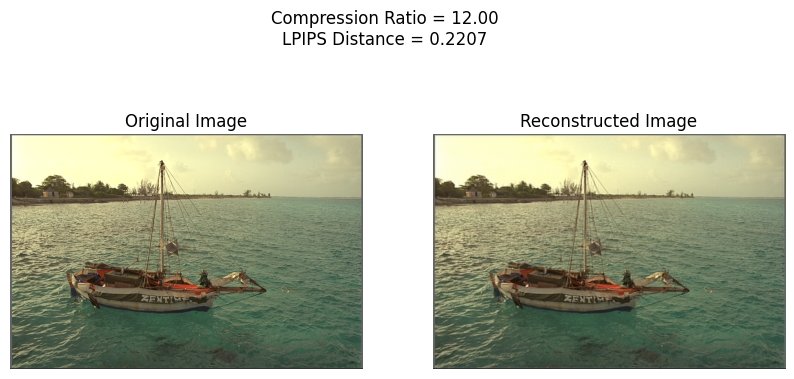

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.11154460906982422


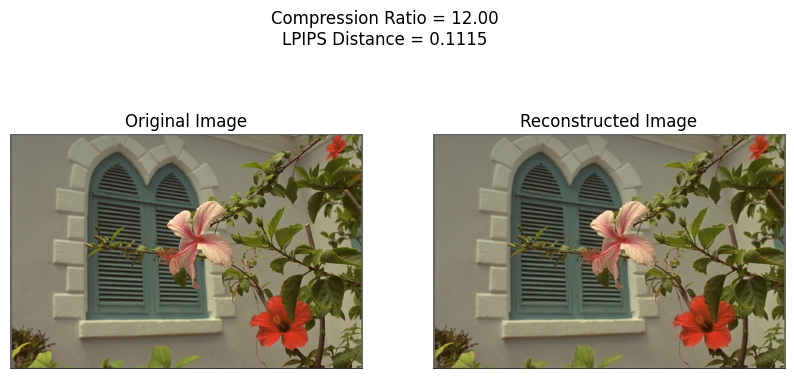

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.23181989789009094


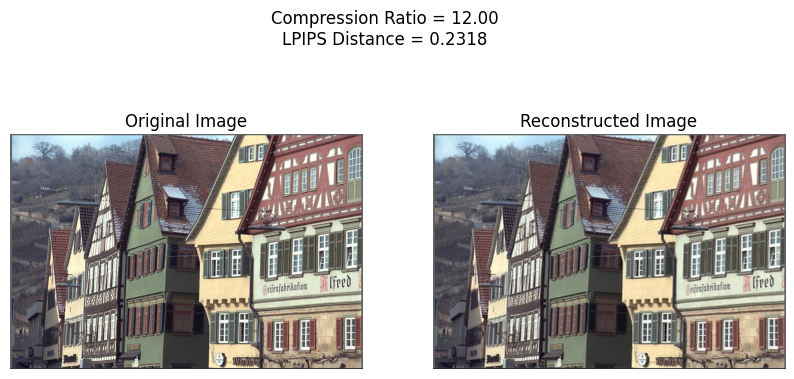

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0
Perceptual similarity (LPIPS): 0.15895742177963257


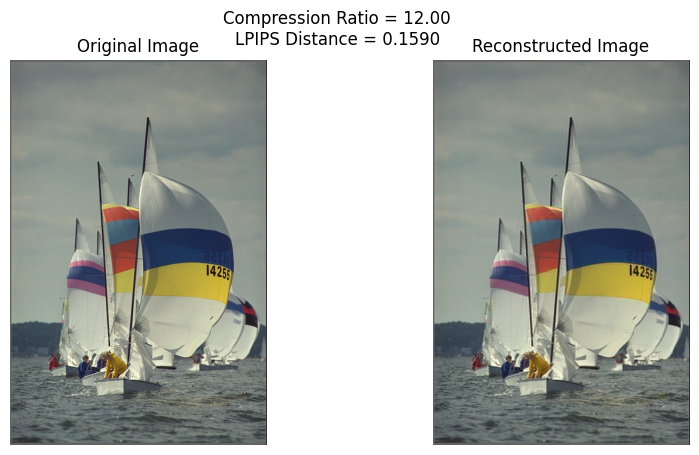

Original image size: 4718592
Compressed image size: 393216
Compression ratio: 12.0


In [9]:
denormalize = transforms.Normalize((-1.0, -1.0, -1.0), (2.0, 2.0, 2.0))

def denormalize_image(tensor):
    return denormalize(tensor)

def quantize(tensor, num_levels):
    min_val = tensor.min()
    max_val = tensor.max()
    scale = (max_val - min_val) / (num_levels - 1)
    quantized = torch.round((tensor - min_val) / scale)
    return quantized, scale, min_val

def dequantize(quantized, scale, min_val):
    dequantized = quantized * scale + min_val
    return dequantized

def compress_image(images, model, num_levels):
    for image in images:
        with torch.no_grad():
            transformed_image = model.conv1(image)
            quantized_image, scale, min_val = quantize(transformed_image, num_levels)
            flat_quantized = quantized_image.flatten().cpu().numpy()
            byte_stream = flat_quantized.tobytes()

            byte_streams.append(byte_stream)
            quantized_images.append(quantized_image.shape)
            scales.append(scale)
            min_vals.append(min_val)
    return byte_streams, quantized_images, scales, min_vals

def decompress_image(byte_streams, shapes, scales, min_vals, model):
    reconstructed_images = []
    for byte_stream, shape, scale, min_val in zip(byte_streams, shapes, scales, min_vals):
        flat_quantized = np.frombuffer(byte_stream, dtype=np.float32)
        quantized_image = torch.tensor(flat_quantized).view(shape).to(model.conv1.weight.device)
        dequantized_image = dequantize(quantized_image, scale, min_val)
        with torch.no_grad():
            dequantized_image = model.conv2(dequantized_image)
        reconstructed_images.append(dequantized_image)
    return reconstructed_images

compressed_byte_streams, shapes, scales, min_vals = compress_image(images, model, num_levels=256)
reconstructed_images = decompress_image(compressed_byte_streams, shapes, scales, min_vals, model)

print(f"Number of original images: {len(images)}")
print(f"Number of reconstructed images: {len(reconstructed_images)}")

for i in range(len(images)):
    original_image_np = denormalize_image(images[i]).squeeze().permute(1, 2, 0).cpu().numpy()
    reconstructed_image_np = denormalize_image(reconstructed_images[i]).squeeze().permute(1, 2, 0).cpu().numpy()
    original_image_np = np.clip(original_image_np, 0, 1)
    reconstructed_image_np = np.clip(reconstructed_image_np, 0, 1)

    original_image_pil = Image.fromarray((original_image_np * 255).astype(np.uint8))
    reconstructed_image_pil = Image.fromarray((reconstructed_image_np * 255).astype(np.uint8))
    # original_image_pil.save(f'original_image_{i}.png')
    # reconstructed_image_pil.save(f'reconstructed_image_{i}.png')
    save_dir = 'compressed images'
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(original_image_np)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Reconstructed Image')
    plt.imshow(reconstructed_image_np)
    plt.axis('off')
    
    original_image_size = images[i].nelement() * images[i].element_size()
    compressed_image_size = len(compressed_byte_streams[i])
    compression_ratio = original_image_size / compressed_image_size
    d = loss_fn.forward(images[i].cpu(), reconstructed_images[i].cpu())
    
    print(f'Perceptual similarity (LPIPS): {d.item()}')

    plt.suptitle(f"Compression Ratio = {compression_ratio:.2f}\nLPIPS Distance = {d.item():.4f}", fontsize=12)
    plt.savefig(os.path.join(save_dir, f'image_comparison_{i}.png'), bbox_inches='tight')
    plt.show()
    
    print(f'Original image size: {original_image_size}')
    print(f'Compressed image size: {compressed_image_size}')
    print(f'Compression ratio: {compression_ratio}')


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\abuma\anaconda3\Lib\site-packages\lpips\weights\v0.1\alex.pth


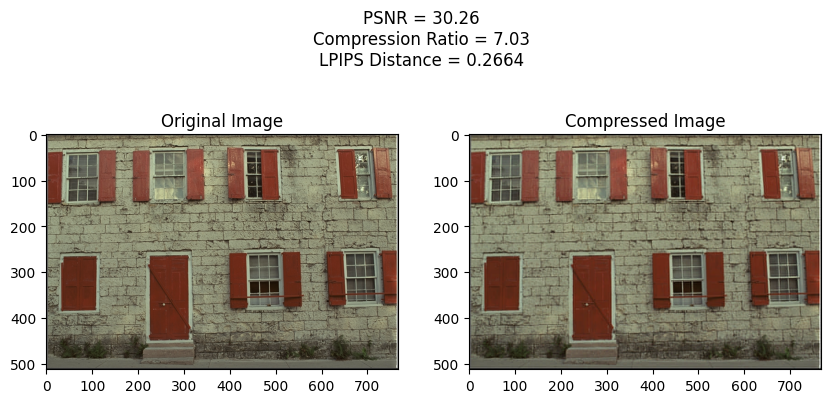

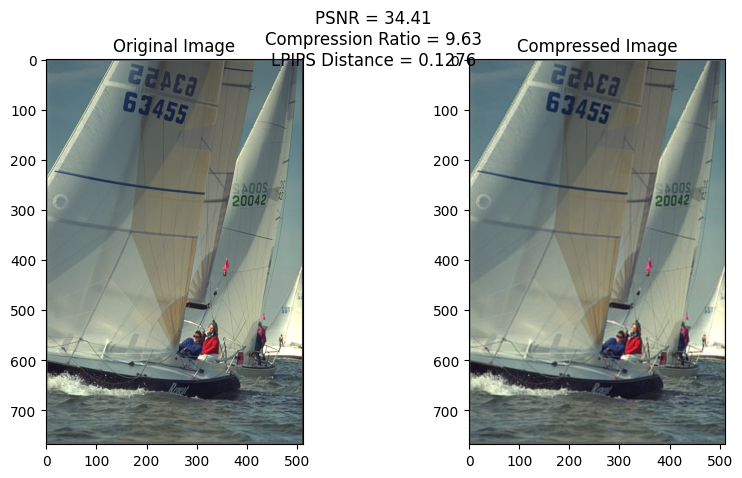

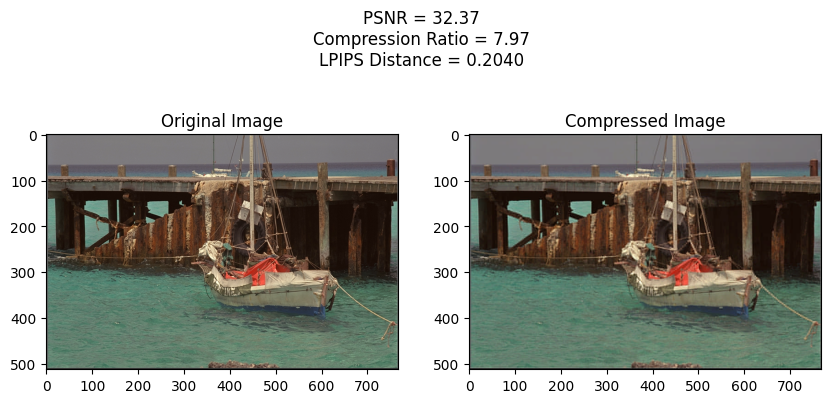

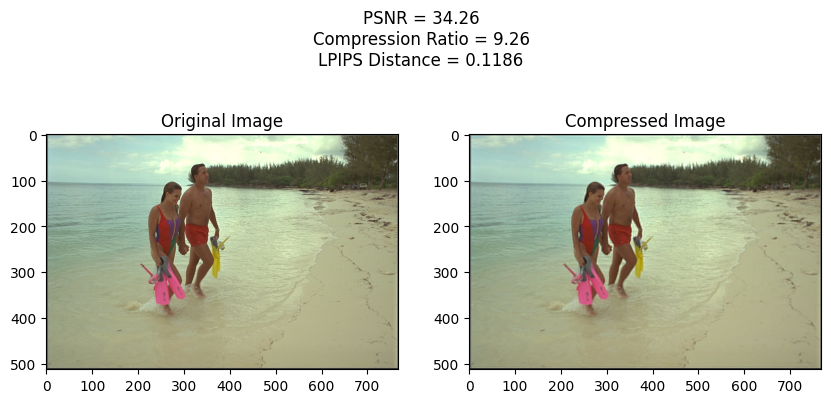

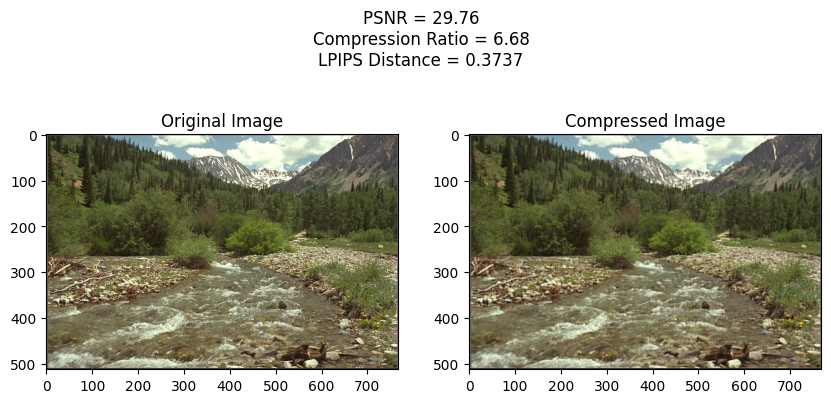

...

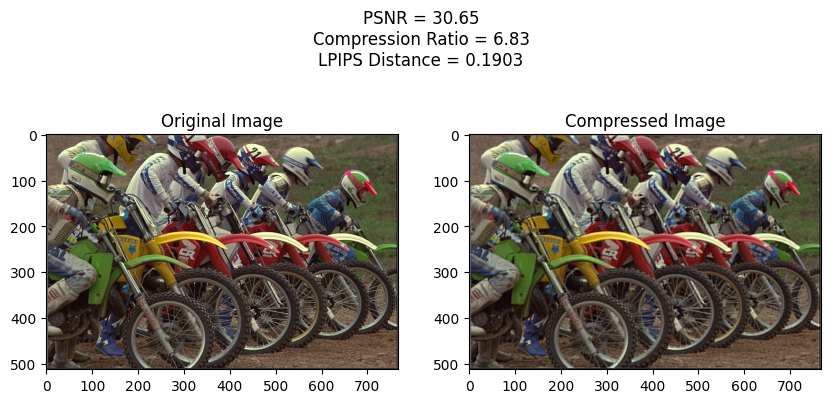

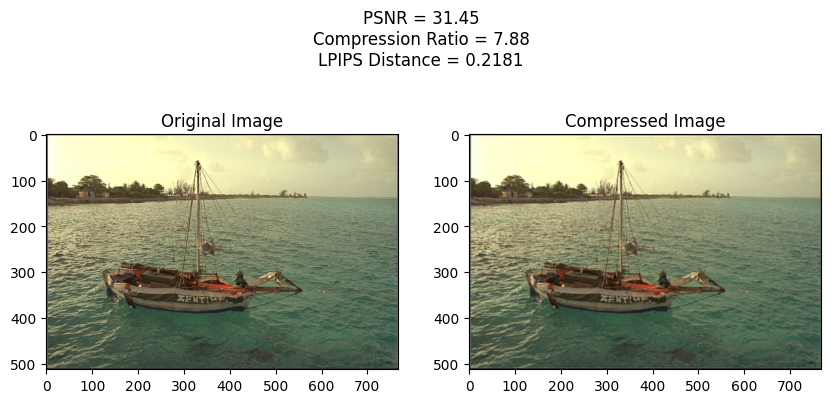

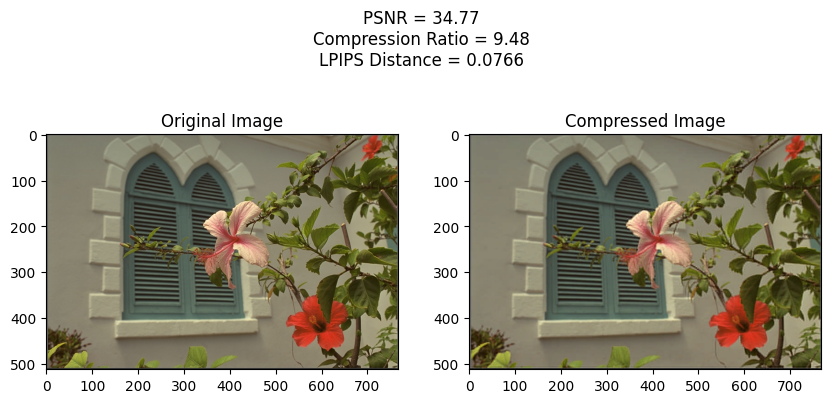

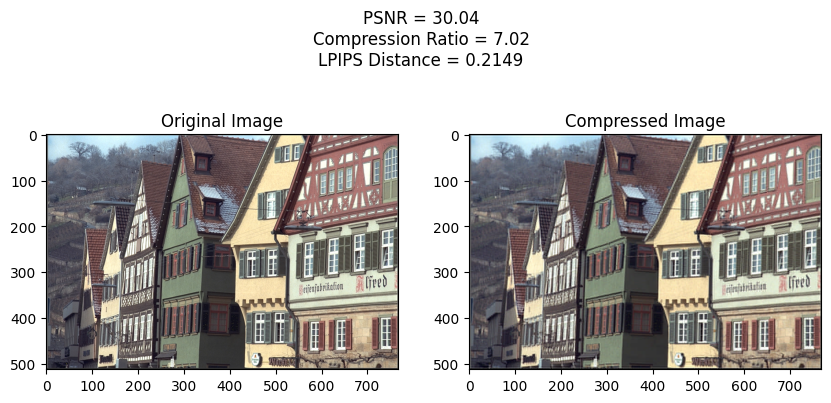

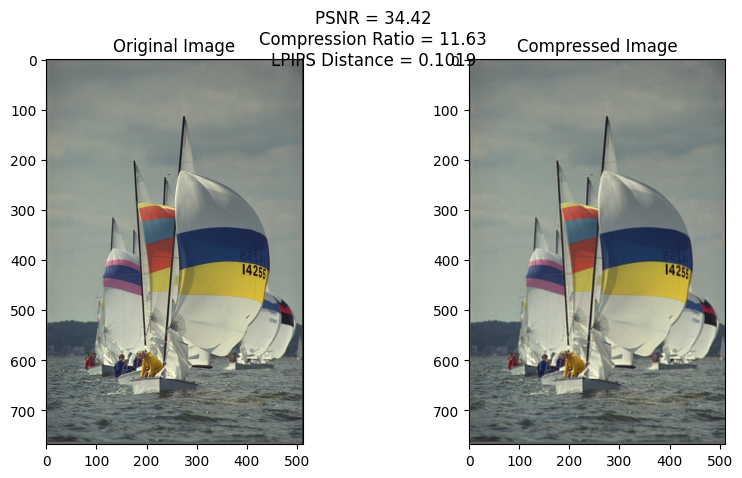

In [10]:
# Import the required modules
import cv2 as cv
import matplotlib.pyplot as plt
import numpy as np
import os
from PIL import Image
import torch
from torchvision import transforms
import lpips  # Make sure lpips is installed and imported

# Initialize the LPIPS loss function with a specific network (e.g., 'alex')
loss_fn = lpips.LPIPS(net='alex').cpu()

# Define the quantization matrix
quantization_matrix = np.array(
    [
        [16, 11, 10, 16, 24, 40, 51, 61],
        [12, 12, 14, 19, 26, 58, 60, 55],
        [14, 13, 16, 24, 40, 57, 69, 56],
        [14, 17, 22, 29, 51, 87, 80, 62],
        [18, 22, 37, 56, 68, 109, 103, 77],
        [24, 35, 55, 64, 81, 104, 113, 92],
        [49, 64, 78, 87, 103, 121, 120, 101],
        [72, 92, 95, 98, 112, 100, 103, 99],
    ],
    dtype=np.float32,
)

def calculate_psnr(img1: np.ndarray[np.uint8], img2: np.ndarray[np.uint8]) -> float:
    """Calculate PSNR using formula: PSNR = 20 * log10(MAX_I) - 10 * log10(MSE)"""
    mse = np.mean((img1 - img2) ** 2)
    psnr = 20 * np.log10(255 / np.sqrt(mse))
    return psnr

def number_of_elements(blocks: list[np.ndarray[np.int32]]) -> int:
    """Calculates the total number of elements in the grayscale JPEG encoded array"""
    total_elements = 0
    for block in blocks:
        # Trim the trailing zeros from the 1D array
        total_elements += np.trim_zeros(block, "b").size
    return total_elements

def total_number_of_elements(
    blocks: list[np.ndarray[np.int32]]
    | tuple[
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
    ],
    color: bool,
) -> int:
    """
    Calculates the total number of elements for both color and grayscale JPEG encoded arrays
    This is a utility function that will be used to calculate the compression ratio
    """
    total_elements = 0
    if color:
        # Add the number of elements for each color channel
        total_elements = (
            number_of_elements(blocks[0])
            + number_of_elements(blocks[1])
            + number_of_elements(blocks[2])
        )
    else:
        total_elements = number_of_elements(blocks)
    return total_elements

def zigzag_scan(block: np.ndarray[np.int32]) -> np.ndarray[np.int32]:
    """
    Scans a block in zigzag order and returns a 1D array
    Each block is assumed to be a square matrix
    """
    block_size = block.shape[0]
    zigzag_arr = np.concatenate(
        [
            np.diagonal(block[::-1, :], i)[:: (2 * (i % 2) - 1)]
            for i in range(1 - block_size, block_size)
        ]
    )
    return zigzag_arr

def zigzag_unscan(
    zigzag_arr: np.ndarray[np.int32], block_size: int
) -> np.ndarray[np.float32]:
    """Unscans a 1D array in zigzag order and returns a 2D array"""
    block = np.zeros((block_size, block_size), dtype=np.float32)
    x, y = 0, 0
    for num in zigzag_arr:
        block[x, y] = num
        if (x + y) % 2 == 0:
            if y == block_size - 1:
                x += 1
            elif x == 0:
                y += 1
            else:
                x -= 1
                y += 1
        else:
            if x == block_size - 1:
                y += 1
            elif y == 0:
                x += 1
            else:
                x += 1
                y -= 1
    return block

def grayscale_jpeg_encoder(
    img: np.ndarray[np.uint8], block_size: int, num_coefficients: int
) -> list[np.ndarray[np.int32]]:
    """Encodes a grayscale image using JPEG compression"""
    height, width = img.shape
    padded_height = height + (block_size - height % block_size) % block_size
    padded_width = width + (block_size - width % block_size) % block_size
    padded_img = np.zeros((padded_height, padded_width), dtype=np.uint8)
    padded_img[:height, :width] = img
    padded_img = padded_img.astype(np.float32) - 128

    blocks = [
        padded_img[i:i + block_size, j:j + block_size]
        for i in range(0, padded_height, block_size)
        for j in range(0, padded_width, block_size)
    ]

    dct_blocks = [cv.dct(block) for block in blocks]
    resized_quantization_matrix = cv.resize(quantization_matrix, (block_size, block_size), cv.INTER_CUBIC)
    quantized_blocks = [np.round(block / resized_quantization_matrix).astype(np.int32) for block in dct_blocks]
    zigzag_scanned_blocks = [zigzag_scan(block) for block in quantized_blocks]
    first_num_coefficients = [block[:num_coefficients] for block in zigzag_scanned_blocks]

    return first_num_coefficients

def grayscale_jpeg_decoder(
    blocks: list[np.ndarray[np.int32]], img: np.ndarray[np.uint8], block_size: int
) -> np.ndarray[np.uint8]:
    """Decodes a grayscale image using JPEG compression"""
    height, width = img.shape
    padded_height = height + (block_size - height % block_size) % block_size
    padded_width = width + (block_size - width % block_size) % block_size

    resized_quantization_matrix = cv.resize(quantization_matrix, (block_size, block_size), cv.INTER_CUBIC)
    zigzag_unscanned_blocks = [zigzag_unscan(block, block_size) for block in blocks]
    dequantized_blocks = [block * resized_quantization_matrix for block in zigzag_unscanned_blocks]
    idct_blocks = [cv.idct(block) for block in dequantized_blocks]

    compressed_img = np.zeros((padded_height, padded_width), dtype=np.float32)
    block_index = 0
    for i in range(0, padded_height, block_size):
        for j in range(0, padded_width, block_size):
            compressed_img[i:i + block_size, j:j + block_size] = idct_blocks[block_index]
            block_index += 1

    compressed_img += 128
    return np.clip(compressed_img[:height, :width], 0, 255).astype(np.uint8)

def color_jpeg_encoder(
    img: np.ndarray[np.uint8], block_size: int, num_coefficients: int
) -> tuple[list[np.ndarray[np.int32]], list[np.ndarray[np.int32]], list[np.ndarray[np.int32]]]:
    """Encodes a color image using JPEG compression"""
    blue_channel, green_channel, red_channel = cv.split(img)
    return (
        grayscale_jpeg_encoder(blue_channel, block_size, num_coefficients),
        grayscale_jpeg_encoder(green_channel, block_size, num_coefficients),
        grayscale_jpeg_encoder(red_channel, block_size, num_coefficients),
    )

def color_jpeg_decoder(
    blocks: tuple[list[np.ndarray[np.int32]], list[np.ndarray[np.int32]], list[np.ndarray[np.int32]]],
    img: np.ndarray[np.uint8],
    block_size: int,
) -> np.ndarray[np.uint8]:
    """Decodes a JPEG encoded color image"""
    blue_channel, green_channel, red_channel = cv.split(img)
    blue_channel = grayscale_jpeg_decoder(blocks[0], blue_channel, block_size)
    green_channel = grayscale_jpeg_decoder(blocks[1], green_channel, block_size)
    red_channel = grayscale_jpeg_decoder(blocks[2], red_channel, block_size)
    return cv.merge((blue_channel, green_channel, red_channel))

def jpeg_encoder(
    img_path: str,
    block_size: int,
    num_coefficients: int,
    color: bool,
) -> (
    list[np.ndarray[np.int32]]
    | tuple[
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
    ]
):
    """Encodes an image using JPEG compression"""
    img = cv.imread(img_path, cv.IMREAD_COLOR if color else cv.IMREAD_GRAYSCALE)
    if img is None:
        raise ValueError(f"Error: Could not open or find the image {img_path}")

    if color:
        return color_jpeg_encoder(img, block_size, num_coefficients)
    else:
        return grayscale_jpeg_encoder(img, block_size, num_coefficients)

def jpeg_decoder(
    blocks: list[np.ndarray[np.int32]]
    | tuple[
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
    ],
    img_path: str,
    block_size: int,
    color: bool,
) -> np.ndarray[np.uint8]:
    """Decodes an image using JPEG compression from its JPEG encoded array"""
    img = cv.imread(img_path, cv.IMREAD_COLOR if color else cv.IMREAD_GRAYSCALE)
    if img is None:
        raise ValueError(f"Error: Could not open or find the image {img_path}")

    if color:
        return color_jpeg_decoder(blocks, img, block_size)
    else:
        return grayscale_jpeg_decoder(blocks, img, block_size)

def analyze_image(
    img_path: str, block_size: int, num_coefficients: int, color: bool
) -> tuple[
    np.ndarray[np.uint8],
    np.ndarray[np.uint8],
    float,
    float,
    list[np.ndarray[np.int32]]
    | tuple[
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
    ],
    bool,
    float,
]:
    """Analyzes the input image by performing JPEG compression and LPIPS calculation"""
    img = cv.imread(img_path, cv.IMREAD_COLOR if color else cv.IMREAD_GRAYSCALE)
    if img is None:
        raise ValueError(f"Error: Could not open or find the image {img_path}")

    # Encode and decode the image using JPEG compression
    encoded_img = jpeg_encoder(img_path, block_size, num_coefficients, color)
    compressed_img = jpeg_decoder(encoded_img, img_path, block_size, color)

    # Calculate the PSNR between the original and compressed images
    psnr = calculate_psnr(img, compressed_img)

    # LPIPS Calculation
    original_image_tensor = transforms.ToTensor()(img).unsqueeze(0).cpu()
    compressed_image_tensor = transforms.ToTensor()(compressed_img).unsqueeze(0).cpu()
    lpips_distance = loss_fn(original_image_tensor, compressed_image_tensor).item()

    # Calculate the compression ratio
    n2 = total_number_of_elements(encoded_img, color)
    compression_ratio = img.size / n2 if n2 != 0 else float('inf')

    return img, compressed_img, psnr, compression_ratio, encoded_img, color, lpips_distance
def plot_images(
    img: np.ndarray[np.uint8],
    compressed_img: np.ndarray[np.uint8],
    psnr: float,
    compression_ratio: float,
    encoded_img: list[np.ndarray[np.int32]]
    | tuple[
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
        list[np.ndarray[np.int32]],
    ],
    color: bool,
    lpips_distance: float,
    counter=[0]
) -> None:
    
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    fig.suptitle(
        f"PSNR = {psnr:.2f}\nCompression Ratio = {compression_ratio:.2f}\nLPIPS Distance = {lpips_distance:.4f}"
    )

    if color:
        axs[0].imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
        axs[1].imshow(cv.cvtColor(compressed_img, cv.COLOR_BGR2RGB))
    else:
        axs[0].imshow(img, cmap="gray")
        axs[1].imshow(compressed_img, cmap="gray")

    axs[0].set_title("Original Image")
    axs[1].set_title("Compressed Image")
    save_dir = "DCT images"
    plt.savefig(os.path.join(save_dir, f'DCT_image_comparison_{counter[0]}.png'), bbox_inches='tight')

    plt.show()

    counter[0] += 1


def plot_graph(
    img_dir_path: str,
    color: bool,
):
    psnr_list = []
    compression_ratio_list = []
    for num_coefficients in [1, 3, 6, 10, 15, 28]:
        psnr_values = []
        compression_ratio_values = []
        for img_file in os.listdir(img_dir_path):
            img_path = os.path.join(img_dir_path, img_file)
            try:
                _, _, psnr, compression_ratio, _, _, _ = analyze_image(
                    img_path, 8, num_coefficients, color
                )
                psnr_values.append(psnr)
                compression_ratio_values.append(compression_ratio)
            except ValueError as e:
                print(e)
                continue

        psnr_list.append(np.mean(psnr_values))
        compression_ratio_list.append(np.mean(compression_ratio_values))

    plt.plot(compression_ratio_list, psnr_list, "o")
    plt.xlabel("Compression Ratio")
    plt.ylabel("PSNR")
    plt.title("PSNR vs Compression Ratio")
    plt.show()

if __name__ == "__main__":
    img_path = "image-compression/images/colored"
    image_paths = [os.path.join(img_path, img_file) for img_file in os.listdir(img_path)]

    for img_file in os.listdir(img_path):
        img_full_path = os.path.join(img_path, img_file)

        # Attempt to load the image
        try:
            original_img, compressed_img, psnr, compression_ratio, encoded_img, is_color, lpips_distance = analyze_image(
                img_full_path, block_size=8, num_coefficients=10, color=True)
            plot_images(original_img, compressed_img, psnr, compression_ratio, encoded_img, is_color, lpips_distance)
        except Exception as e:
            print(f"An error occurred while processing {img_full_path}: {e}")


### <span style="color:blue"> END Report here </span>